#### Imports

In [1]:
import spotipy
import spotipy.util as util
from spotipy.oauth2 import SpotifyClientCredentials

import os
import urllib.request

%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from PIL import Image

#### Spotipy setup

In [2]:
cId = "xxx"
cSecret = "xxx"
redirectURI = "https://google.com/"
username = "xxx"

client_credentials_manager = SpotifyClientCredentials(client_id=cId, client_secret=cSecret)
sp = spotipy.Spotify(client_credentials_manager=client_credentials_manager)

scope = 'user-library-read user-read-currently-playing user-read-playback-state user-read-recently-played'
token = util.prompt_for_user_token(username, scope, cId, cSecret, redirectURI)

if token:
    sp = spotipy.Spotify(auth=token)
else:
    print("Can't get token for", username)

In [3]:
# usually takes some time to execute...

urllist = []

c = 25
r = 9
limit = c
amount = c*r*2

for i in range(0, amount, limit):
    
    saved_tracks = sp.current_user_saved_tracks(limit=limit, offset=i)
    
    for t in saved_tracks['items']:
        track = t['track']
        track_album = track['album']
        url = track_album['images'][0]['url']
        urldict={
            'id': track_album['id'],
            'name': track_album['name'],
            'url': url
        }        
        urllist.append(urldict)

In [4]:
df = pd.DataFrame(urllist)
df.drop_duplicates(keep='first', inplace=True) # drop duplicate albums
df.reset_index(inplace=True)
df.drop('index', axis=1, inplace=True)
# df

In [5]:
# create images folder

img_folder_name = 'images'
if not os.path.exists(img_folder_name):
    os.makedirs(img_folder_name)

In [6]:
# usually takes some time to execute...

for index, row in df.iterrows():
    url = row['url']
    name = str(index+1)
    urllib.request.urlretrieve(url, img_folder_name + '/' + name + '.jpeg')

    res = (index + 1) % (r*c)
    if res == 0:
        break;

In [7]:
def collage(array, ncols=20):
    nindex, height, width, intensity = array.shape
    nrows = nindex//ncols
    assert nindex == nrows*ncols
    result = (
        array
        .reshape(nrows, ncols, height, width, intensity)
        .swapaxes(1, 2)
        .reshape(height*nrows, width*ncols, intensity)
    )
    return result

def make_array():
    l = []
    
    for file_name in os.listdir(img_folder_name):
        if '.jpeg' in file_name:
            file = img_folder_name + '/' + file_name
            im = Image.open(file).convert('RGB')
            if im.size == (640, 640):
                l.append(file)

    l = l[:200]
    
    return np.array([np.asarray(Image.open(file_name).convert('RGB')) for file_name in l])

arr = make_array()
print('shape', arr.shape)

shape (200, 640, 640, 3)


In [8]:
# usually takes some time to execute...
result = collage(arr)

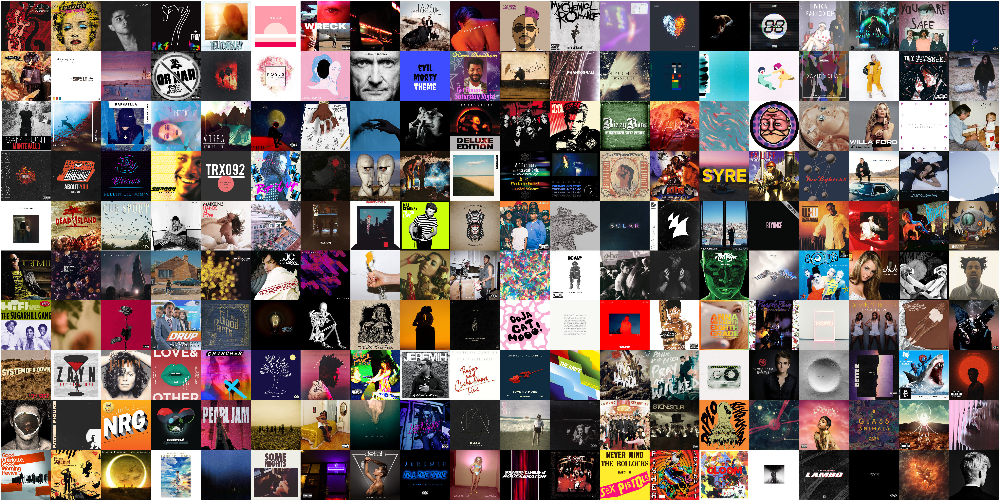

In [9]:
# usually takes some time to execute...

# set figure size
s = 70
plt.figure(figsize=(s,s))

# show result for plot
plt.imshow(result)

# get rid of axes
plt.axis('off')

# save file with no white padding
plt.gca().set_axis_off()
plt.subplots_adjust(
    top = 1,
    bottom = 0,
    right = 1,
    left = 0, 
    hspace = 0,
    wspace = 0
)
plt.margins(0,0)
plt.gca().xaxis.set_major_locator(plt.NullLocator())
plt.gca().yaxis.set_major_locator(plt.NullLocator())
plt.savefig(
    "collage.jpeg",
    bbox_inches = 'tight',
    pad_inches = 0
)